In [1]:
from __future__ import division
from __future__ import print_function  
import warnings
import pandas as pd
import gsp_support as gsp
import matplotlib.pyplot as plt
import numpy as np
pd.options.plotting.backend = "plotly"
import datetime

# importing libraries for the plot

from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import seaborn as sns
sns.set(font_scale=1.5, style="whitegrid")

from matplotlib.dates import DateFormatter
import matplotlib.dates as mdates
import dataframe_image as dfi
import math

In [2]:
output_folder = 'FINAL/av_data/'

In [51]:
output = 'FINAL/av_data/monthwise CF/'

In [3]:
total = pd.read_csv(output_folder+'3 min disaggregated result FINAL with removed meters Mar-Oct.csv')

total['x_Timestamp'] = pd.to_datetime(total['x_Timestamp'])
total = total.set_index('x_Timestamp')

In [5]:
hh_list = list(total['meter'].unique())
hh_list = sorted(hh_list)

In [7]:
def func(df):
    h = 0
    print('ok')
    h = h+1
    print(h)
   
    dff = df.loc[df['ac_on']==1] 
    k = len(np.unique(df.index.date))
    c = len(np.unique(dff.index.date))
    
    j = c/k
 
    return j


In [11]:
month = list(total['m-y'].unique())

In [12]:
month

['2019-05',
 '2019-06',
 '2019-07',
 '2019-08',
 '2019-09',
 '2019-10',
 '2020-03',
 '2020-04',
 '2020-05',
 '2020-06',
 '2020-07',
 '2020-08',
 '2020-09',
 '2020-10']

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:21: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: ht

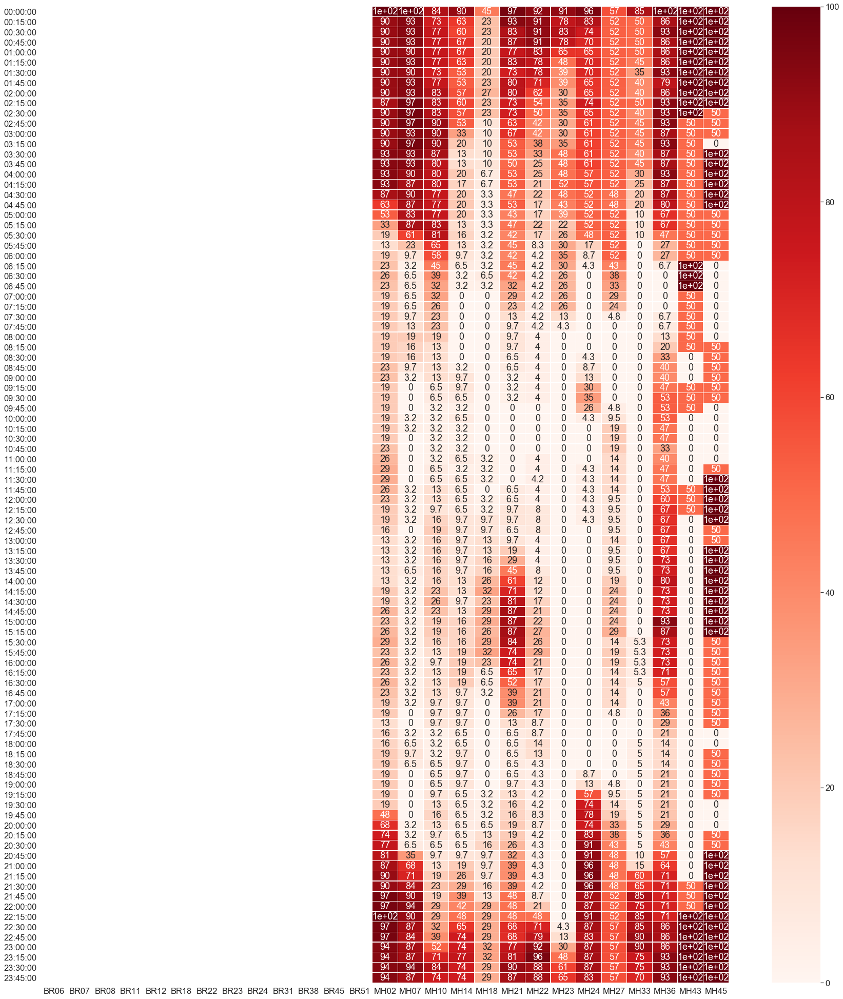

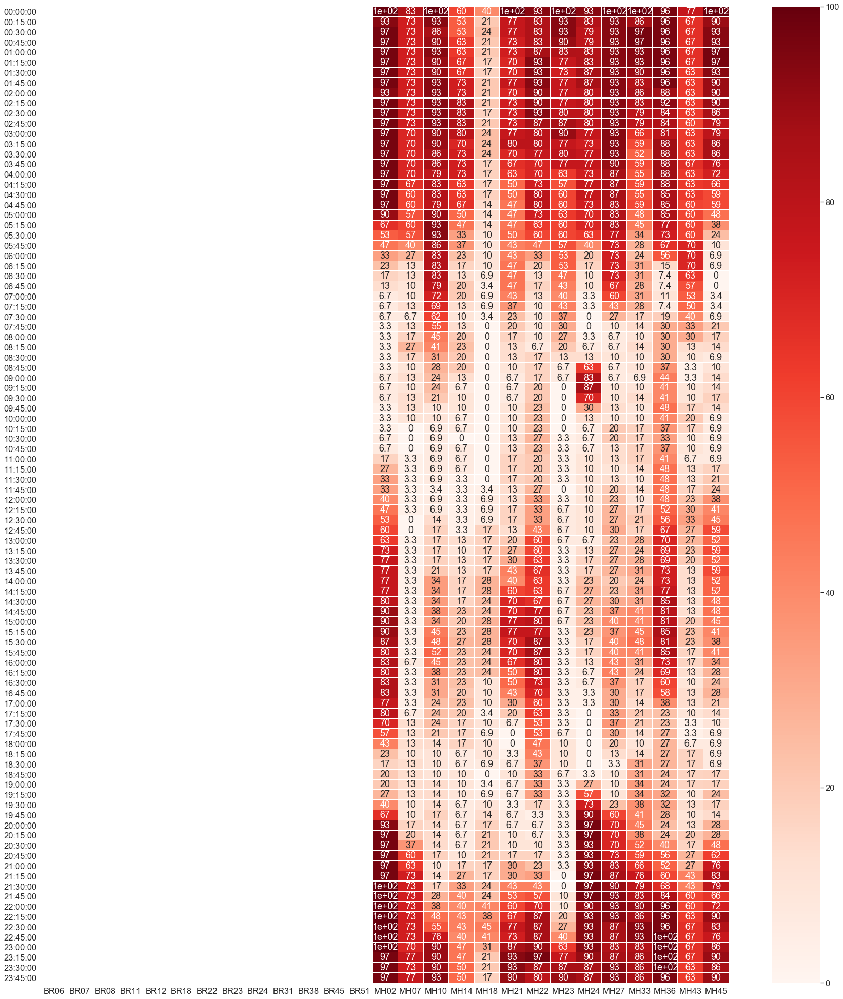

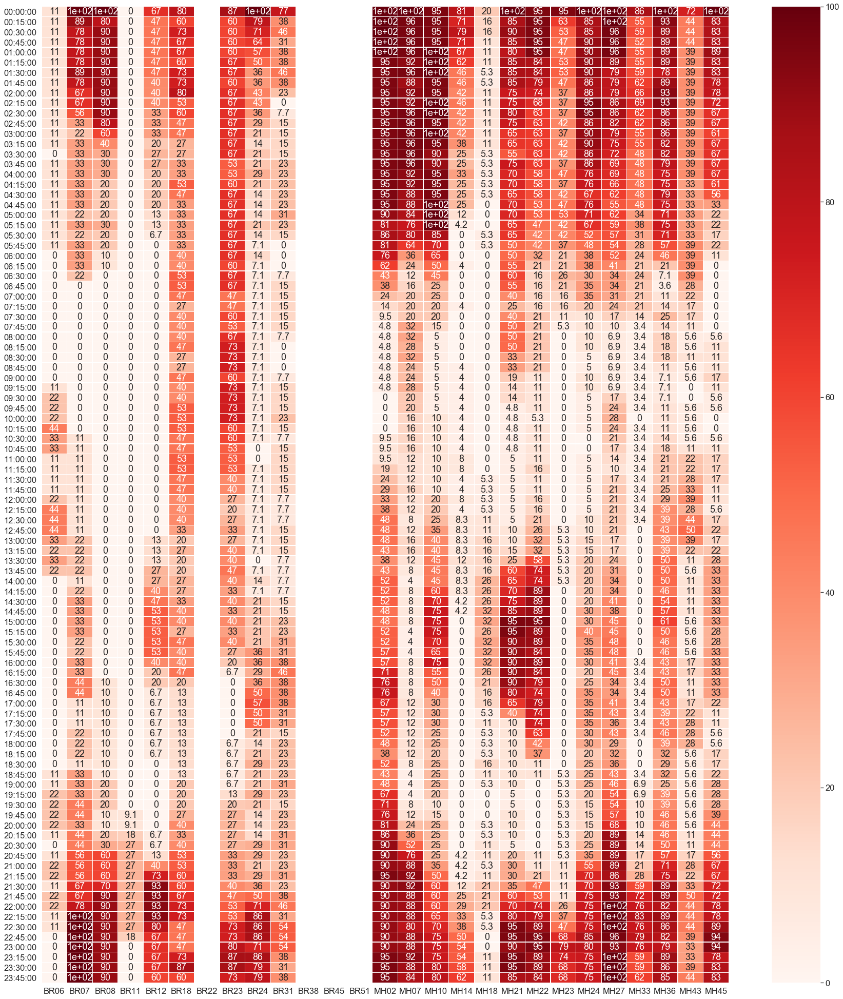

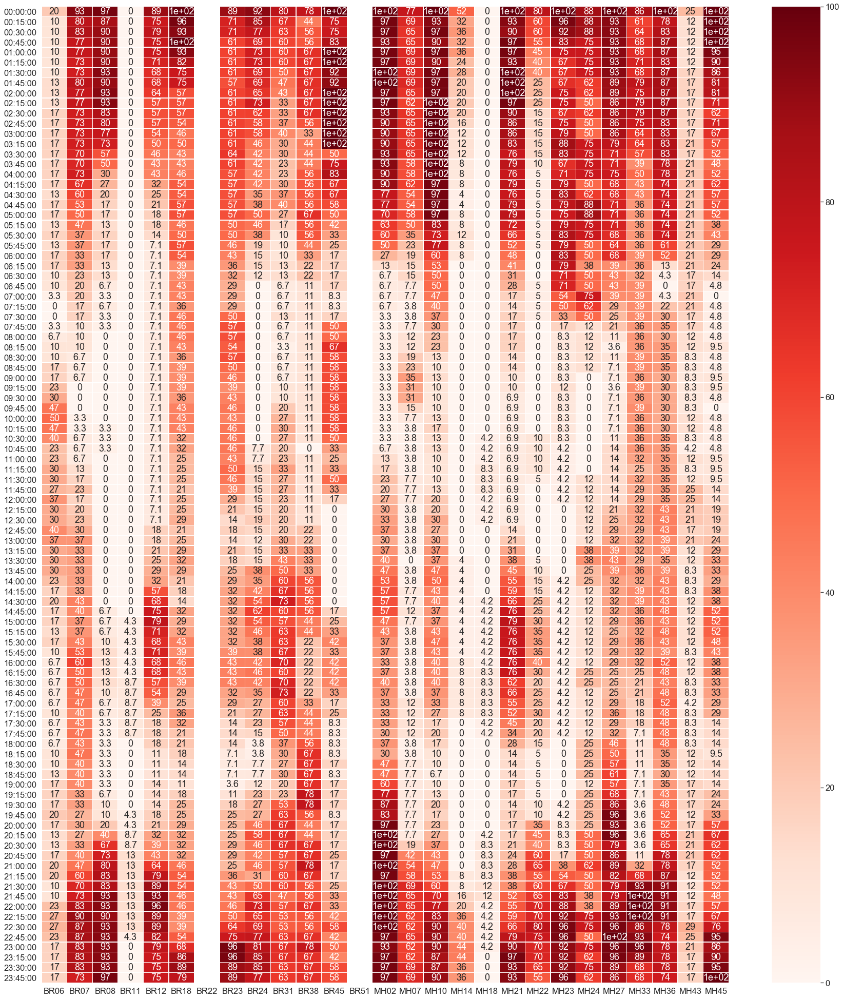

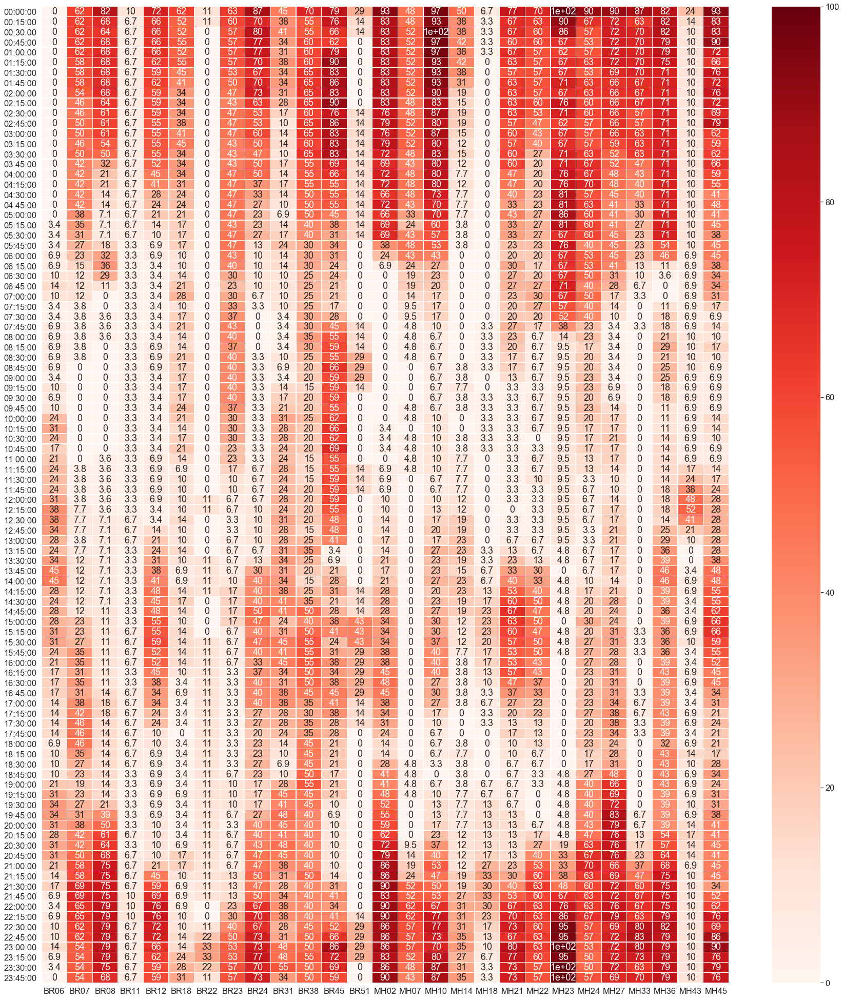

...

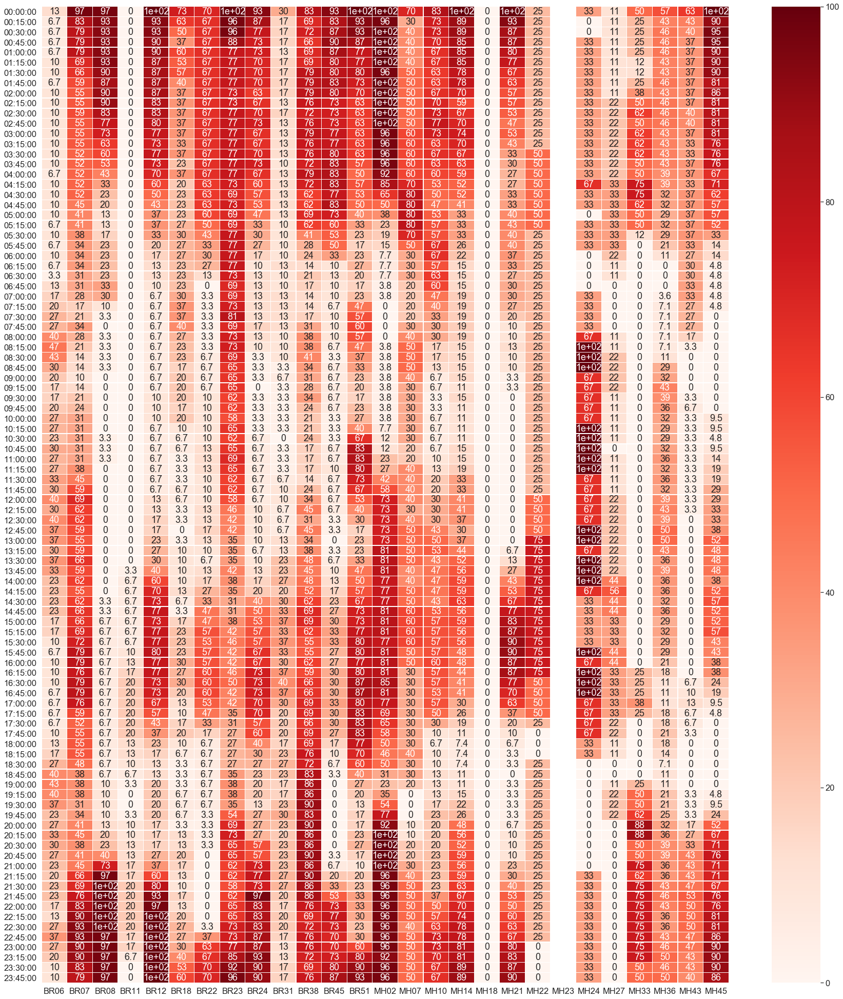

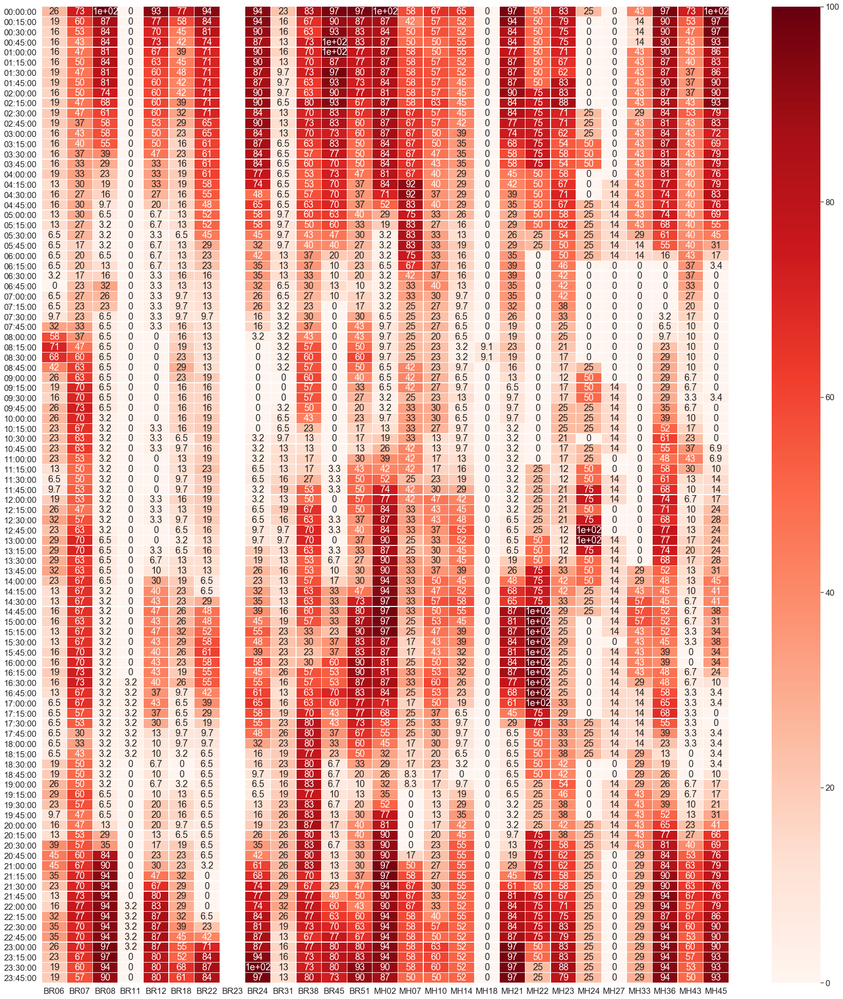

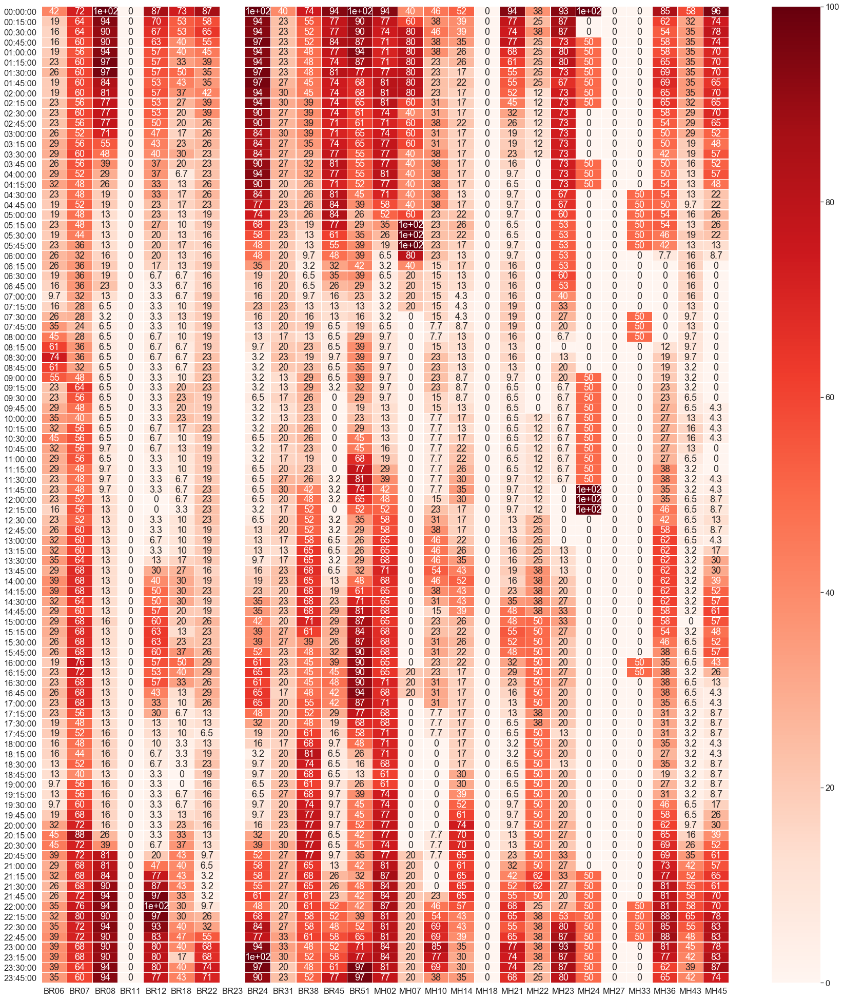

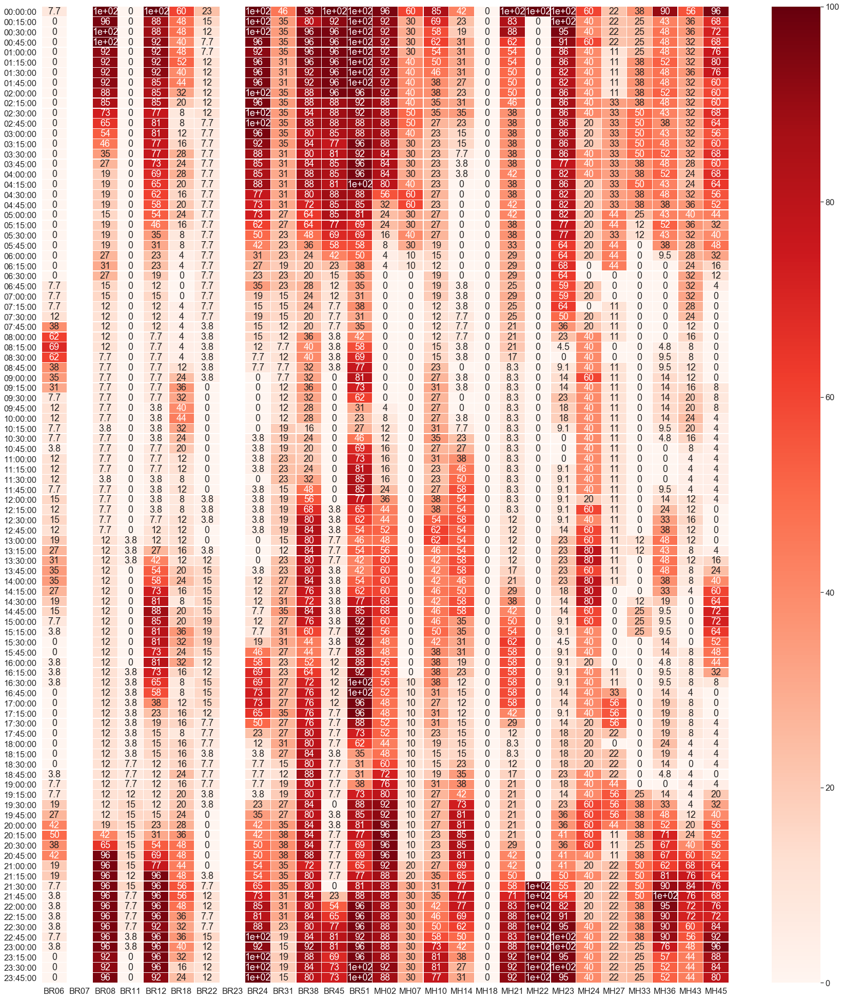

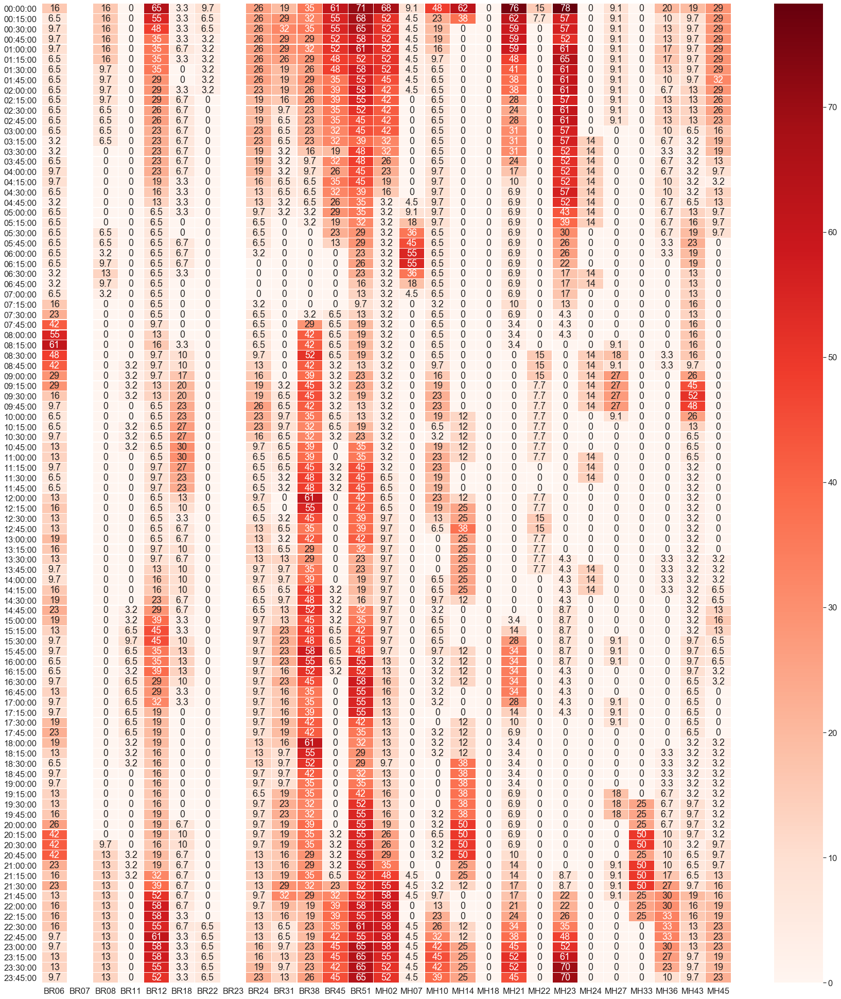

In [57]:
year = [2019,2020]

# need to make a list of dicts

for m in month:
    d = {k:[] for k in hh_list}

    df = total.loc[total['m-y']==m]
    df['time'] = df.index

    i = 0
    ind = []
    for hh in hh_list:
        
        sub = df.loc[df['meter']==hh]
        if sub.shape[0]==0:
            j = np.nan
            d[hh].append(j)

        else:
            sub['quarter'] = sub['time'].dt.round('15min')
            sub['quarter'] = sub['quarter'].dt.time
            groupedd = sub.groupby('quarter')
            for n,g in groupedd:
                subb = groupedd.get_group(n)
                k = len(np.unique(subb.index.date))
                dff = subb.loc[subb['ac_on']==1] 
                c = len(np.unique(dff.index.date))
                j = c/k
                j = j*100
                d[hh].append(j) 
            
                if hh=='MH10':
                    ind.append(n)
    df_ = pd.DataFrame(d,index=ind)
    fig, ax = plt.subplots(figsize = (30, 35))

    sns.heatmap(df_, cmap ='Reds', linewidths = 0.30, annot = True)
    plt.yticks(rotation=0) 

    plt.show()
    fig.savefig(output+m+'CF.png')



C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  if __name__ == '__main__':
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: ht

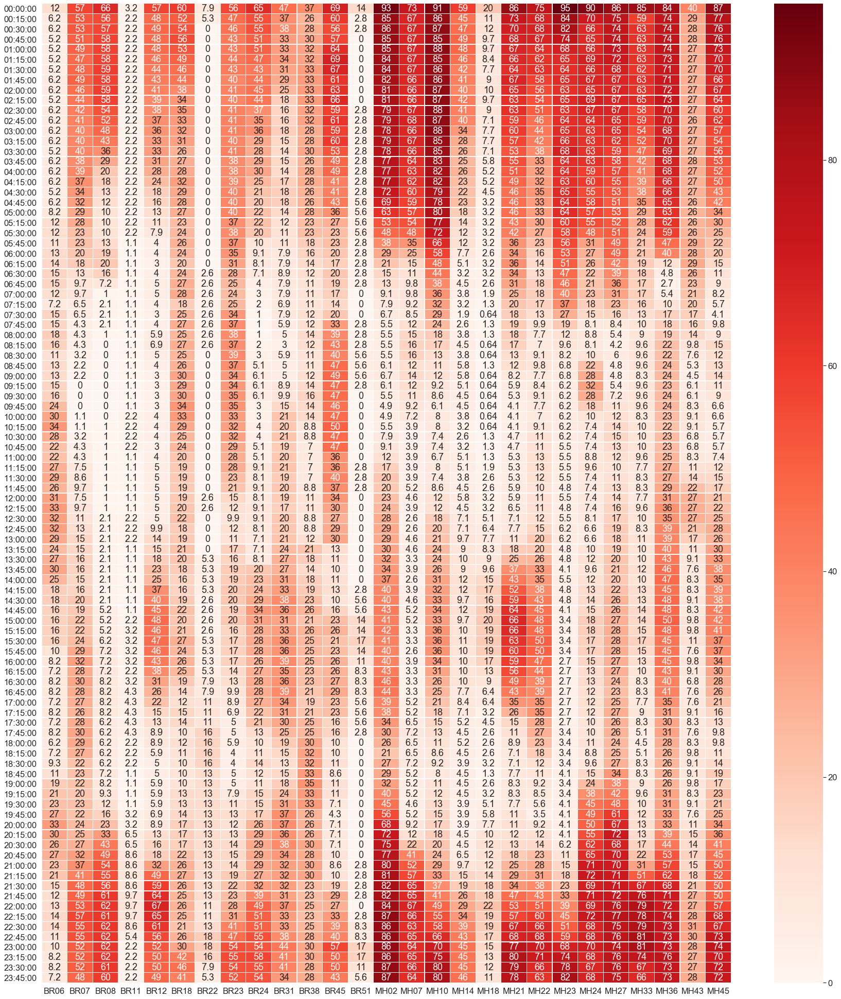

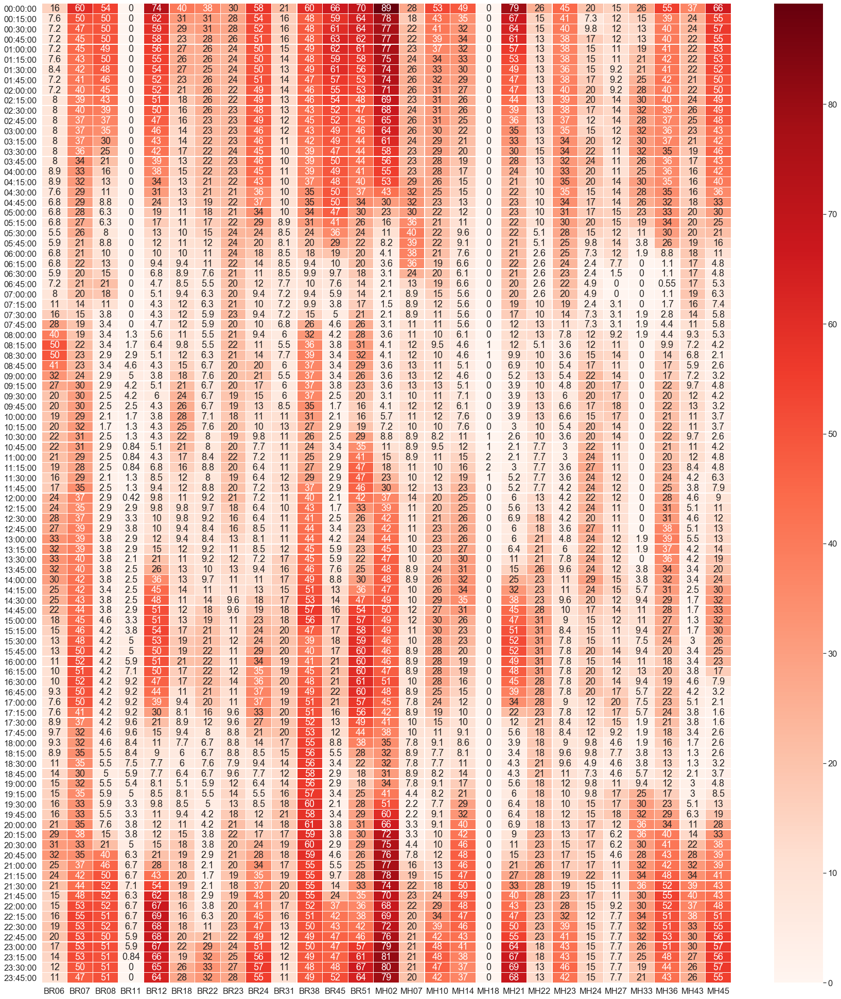

In [55]:
year = [2019,2020]

# need to make a list of dicts

for y in year:
    d = {k:[] for k in hh_list}

    df = total.loc[total.index.year==y]
    df['time'] = df.index

    i = 0
    ind = []
    for hh in hh_list:
        
        sub = df.loc[df['meter']==hh]
    
        sub['quarter'] = sub['time'].dt.round('15min')
        sub['quarter'] = sub['quarter'].dt.time
        groupedd = sub.groupby('quarter')
        
        for n,g in groupedd:
            subb = groupedd.get_group(n)
            k = len(np.unique(subb.index.date))
            dff = subb.loc[subb['ac_on']==1] 
            c = len(np.unique(dff.index.date))
            j = c/k
            j = j*100
            d[hh].append(j) 

            if hh=='MH10':
                ind.append(n)
    df_ = pd.DataFrame(d,index=ind)
    fig, ax = plt.subplots(figsize = (30, 35))

    sns.heatmap(df_, cmap ='Reds', linewidths = 0.30, annot = True)
    plt.yticks(rotation=0) 

    plt.show()
    fig.savefig(output+str(y)+'overall CF.png')



In [52]:
m

'2019-06'

In [20]:
ind

[datetime.time(0, 0),
 datetime.time(0, 15),
 datetime.time(0, 30),
 datetime.time(0, 45),
 datetime.time(1, 0),
 datetime.time(1, 15),
 datetime.time(1, 30),
 datetime.time(1, 45),
 datetime.time(2, 0),
 datetime.time(2, 15),
 datetime.time(2, 30),
 datetime.time(2, 45),
 datetime.time(3, 0),
 datetime.time(3, 15),
 datetime.time(3, 30),
 datetime.time(3, 45),
 datetime.time(4, 0),
 datetime.time(4, 15),
 datetime.time(4, 30),
 datetime.time(4, 45),
 datetime.time(5, 0),
 datetime.time(5, 15),
 datetime.time(5, 30),
 datetime.time(5, 45),
 datetime.time(6, 0),
 datetime.time(6, 15),
 datetime.time(6, 30),
 datetime.time(6, 45),
 datetime.time(7, 0),
 datetime.time(7, 15),
 datetime.time(7, 30),
 datetime.time(7, 45),
 datetime.time(8, 0),
 datetime.time(8, 15),
 datetime.time(8, 30),
 datetime.time(8, 45),
 datetime.time(9, 0),
 datetime.time(9, 15),
 datetime.time(9, 30),
 datetime.time(9, 45),
 datetime.time(10, 0),
 datetime.time(10, 15),
 datetime.time(10, 30),
 datetime.time(10, 